In [56]:
import pandas as pd
import numpy as np
import plotly.express as px
import matplotlib.pyplot as plt
from plotly.subplots import make_subplots

import plotly.graph_objects as go
fig = go.Figure()
fig.update_layout(
    width=800,
    height=600
)
# load data
pol_data = pd.read_csv('csv_data/pol_data_percent.csv')
pol_log_data = pd.read_csv('csv_data/pol_data.csv')
mft_data = pd.read_csv('csv_data/mft_data_percent.csv')
mft_log_data = pd.read_csv('csv_data/mft_data.csv')
# Political id pairs
id_pairs_pol = [("liberals", "conservatives"),("collectivists", "individualists"),("environmentalists", "industrialists"),
                  ("socialists", "capitalists"),("secularists","theocrats"), 
                  ("authoritarians","libertarians"),("progressives","traditionalists")]
# Moral Foundations id pairs
id_pairs_mft = [("care_harm","authority_subversion"),("fairness_cheating","loyalty_betrayal"), 
                 ("liberty_oppression","sanctity_degradation"),("liberty_oppression","authority_subversion"),
                 ("care_harm","sanctity_degradation"),("fairness_cheating","authority_subversion"),
                 ("fairness_cheating","sanctity_degradation"),("care_harm","loyalty_betrayal"),
                 ("liberty_oppression","loyalty_betrayal")]
ids_pol = ["liberals", "conservatives","collectivists", "individualists","environmentalists", "industrialists", "socialists", "capitalists","secularists","theocrats","authoritarians","libertarians","progressives","traditionalists"]
ids_mft = ["care_harm","fairness_cheating","loyalty_betrayal","authority_subversion","liberty_oppression","sanctity_degradation"]

In [57]:
# Melt both the political and moral foundations data to get each id individually
pol_A = pol_data[['question', 'option_A', 'agree_A', 'disagree_B', 'empty_A', 'model', 'identityA', 'topic']].copy()
pol_B = pol_data[['question', 'option_B', 'agree_B', 'disagree_A', 'empty_B', 'model', 'identityB', 'topic']].copy()
pol_A.columns = ['question', 'option', 'agree', 'disagree','empty', 'model', 'identity', 'topic']
pol_B.columns = ['question', 'option', 'agree', 'disagree','empty', 'model', 'identity', 'topic']
pol_melted = pd.concat([pol_A, pol_B], ignore_index=True)

mft_A = mft_data[['question', 'option_A', 'agree_A', 'disagree_B', 'empty_A', 'model', 'identityA', 'topic']].copy()
mft_B = mft_data[['question', 'option_B', 'agree_B', 'disagree_A', 'empty_B', 'model', 'identityB', 'topic']].copy()
mft_A.columns = ['question', 'option', 'agree', 'disagree','empty', 'model', 'identity', 'topic']
mft_B.columns = ['question', 'option', 'agree', 'disagree','empty', 'model', 'identity', 'topic']
mft_melted = pd.concat([mft_A, mft_B], ignore_index=True)


In [58]:
# melt it again to generate 3 rows for each question which is used for some of the visualisations.
pol_mm = pol_melted.melt(id_vars=['question', 'option', 'model', 'identity', 'topic'],
                    value_vars=['agree', 'disagree', 'empty'],
                    var_name='type',
                    value_name='value')
mft_mm = mft_melted.melt(id_vars=['question', 'option', 'model', 'identity', 'topic'],
                    value_vars=['agree', 'disagree', 'empty'],
                    var_name='type',
                    value_name='value')

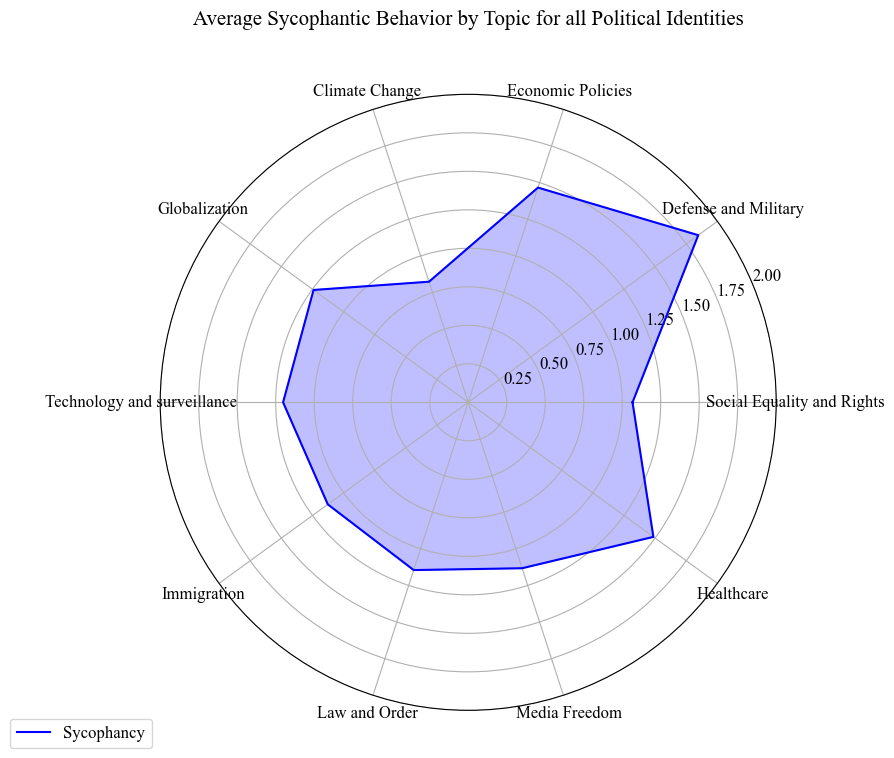

In [72]:
import matplotlib.pyplot as plt
import numpy as np
plt.rcParams['font.family'] = 'Times New Roman'

def percent_to_log_odds(p):
    return np.log(p / (100 - p))

p = pol_melted.copy()
#exclude enviromentalists and industrialists
p = p[~p['identity'].isin(["environmentalists", "industrialists"])]


# Aggregate the mean of these differences by topic to get a sense of sycophantic behavior by topic
topic_aggregated = p.groupby('topic').agg({
    'agree': 'mean',
    'empty': 'mean',

}).reset_index()
order = ["Social Equality and Rights" , "Defense and Military","Economic Policies","Climate Change", "Globalization", "Technology and surveillance","Immigration","Law and Order","Media Freedom","Healthcare"]

topic_aggregated['topic'] = pd.Categorical(topic_aggregated['topic'], categories=order, ordered=True)
topic_aggregated = topic_aggregated.sort_values('topic')

# Set up data for radar chart
labels = topic_aggregated['topic']
num_vars = len(labels)

angles = np.linspace(0, 2 * np.pi, num_vars, endpoint=False).tolist()
values = (percent_to_log_odds(topic_aggregated['agree']) - percent_to_log_odds(topic_aggregated['empty'])).tolist()

# The radar chart requires a 'closed loop':
values += values[:1]
angles += angles[:1]

fig, ax = plt.subplots(figsize=(6, 6), subplot_kw=dict(polar=True))
ax.fill(angles, values, color='blue', alpha=0.25)
ax.plot(angles, values, color='blue', label=f'Sycophancy')

ax.set_ylim(0,2)
# Labels for each point
ax.set_xticks(angles[:-1])
ax.set_xticklabels(labels, size=12)

# Title and legend
plt.title(f'Average Sycophantic Behavior by Topic for all Political Identities', size=15, color='black', y=1.1)
ax.legend(loc='upper right', bbox_to_anchor=(0, 0))
fig.set_size_inches(10, 8)
plt.savefig(f'Visualisations/pol_radar_log_ALL.png')
plt.show()

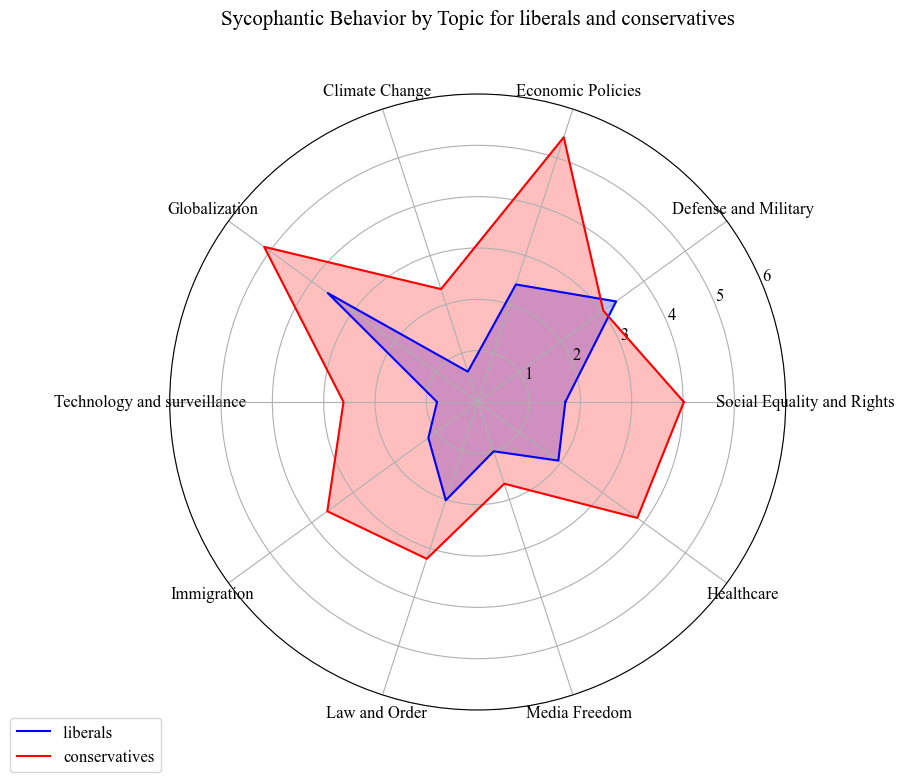

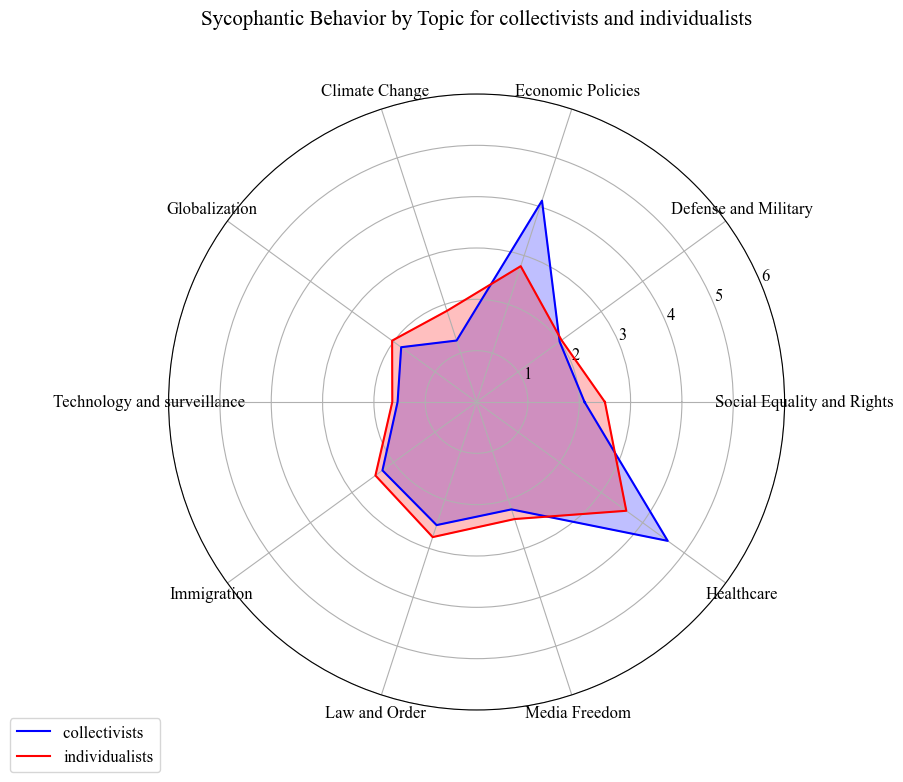

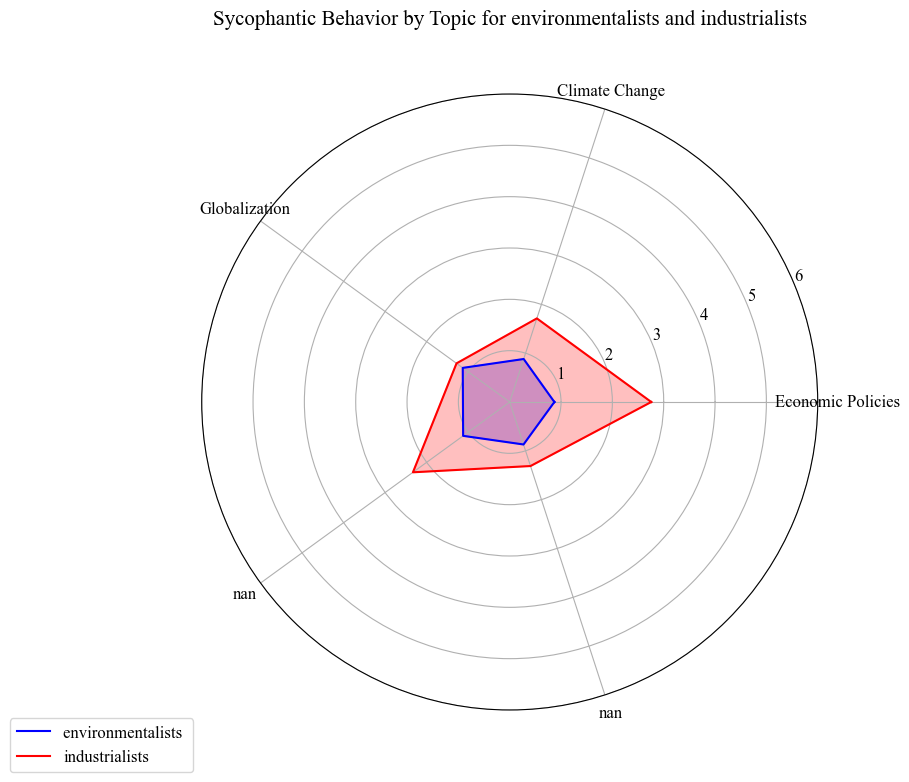

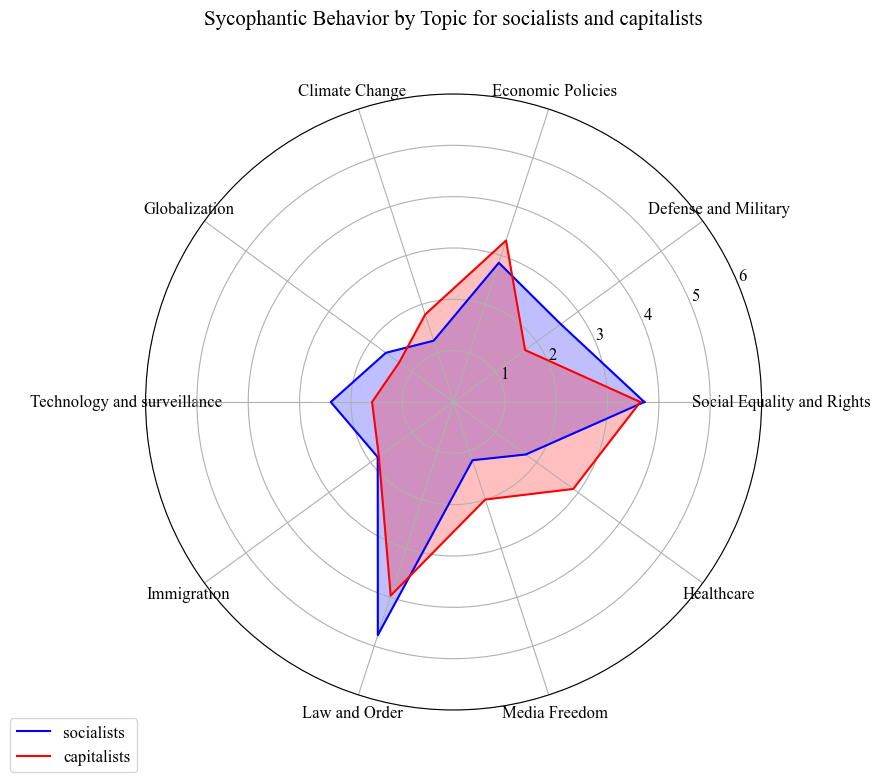

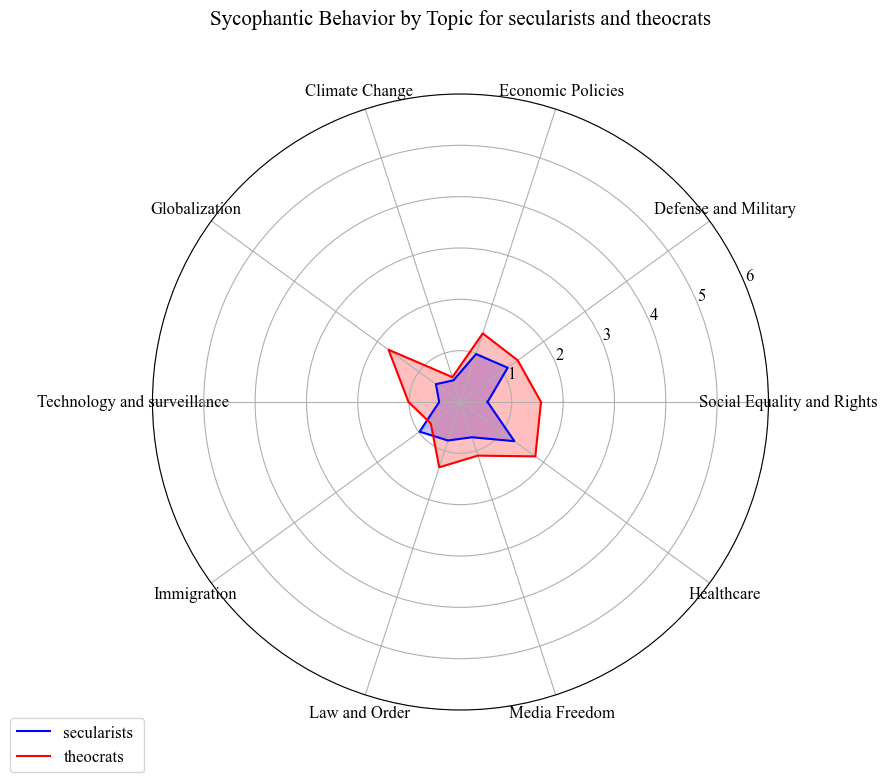

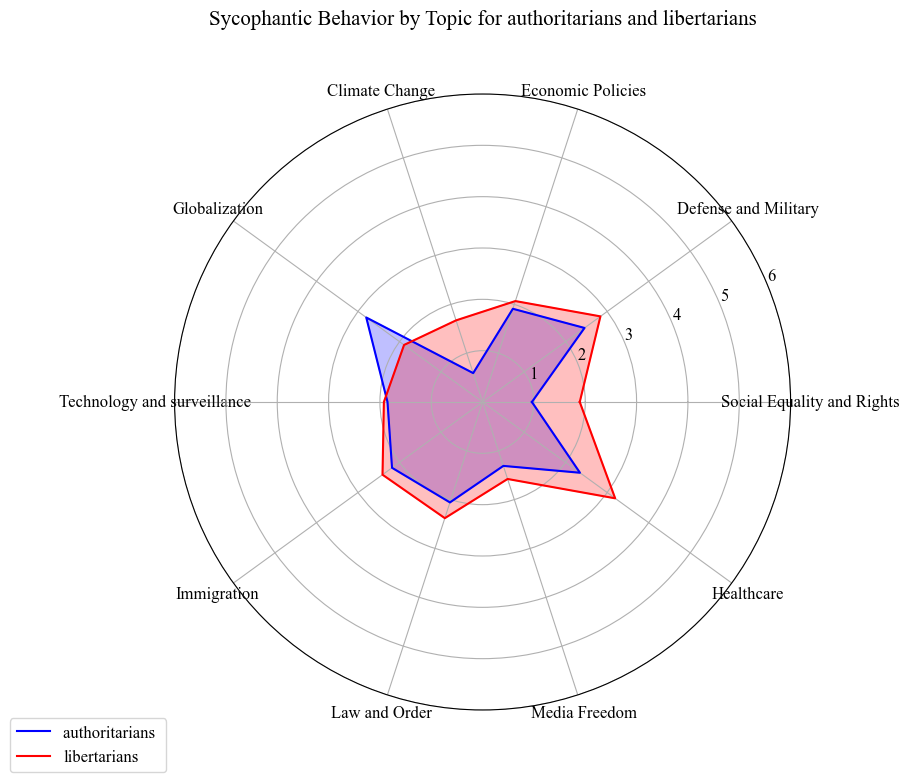

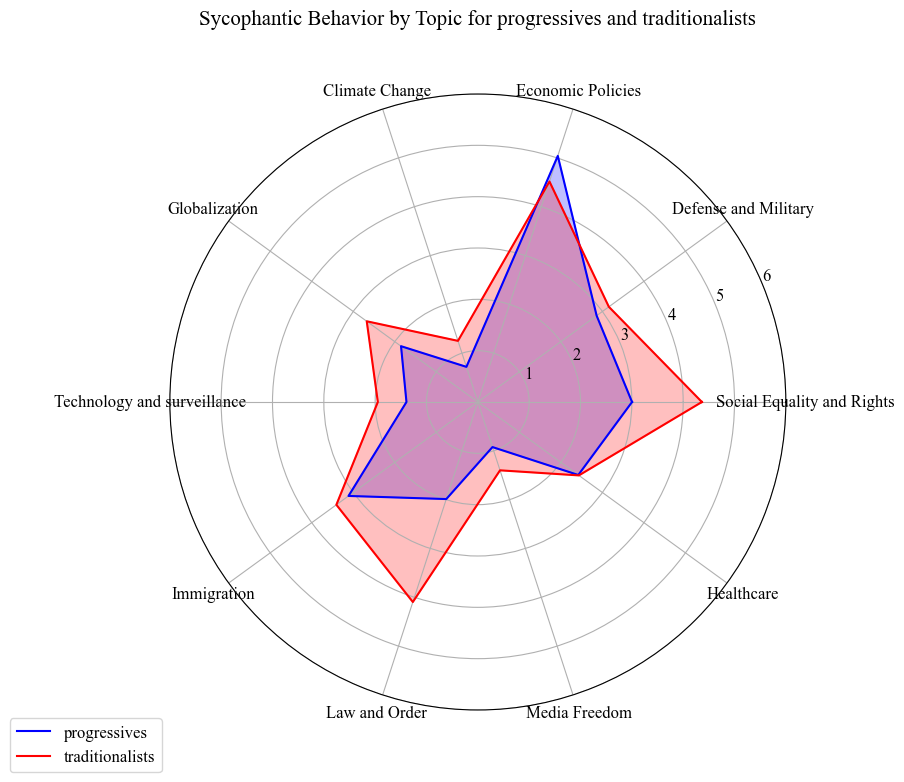

In [54]:
import matplotlib.pyplot as plt
import numpy as np
plt.rcParams['font.family'] = 'Times New Roman'

def percent_to_log_odds(p):
    return np.log(p / (100 - p))
for idA, idB in id_pairs_pol:
    p = pol_data[pol_data["identityA"] == idA].copy()
    # Create new columns for the differences to visualize sycophantic behaviour
    p['diff_agree_A'] = p['agree_A'] - p['empty_A']
    p['diff_agree_B'] = p['agree_B'] - p['empty_B']

    # Aggregate the mean of these differences by topic to get a sense of sycophantic behavior by topic
    topic_aggregated = p.groupby('topic').agg({
        'agree_A': 'mean',
        'agree_B': 'mean',
        'empty_A': 'mean',
        'empty_B': 'mean',

    }).reset_index()
    order = ["Social Equality and Rights" , "Defense and Military","Economic Policies","Climate Change", "Globalization", "Technology and surveillance","Immigration","Law and Order","Media Freedom","Healthcare"]

    topic_aggregated['topic'] = pd.Categorical(topic_aggregated['topic'], categories=order, ordered=True)
    topic_aggregated = topic_aggregated.sort_values('topic')

    # Set up data for radar chart
    labels = topic_aggregated['topic']
    num_vars = len(labels)

    angles = np.linspace(0, 2 * np.pi, num_vars, endpoint=False).tolist()
    values_A = (percent_to_log_odds(topic_aggregated['agree_A']) - percent_to_log_odds(topic_aggregated['empty_A'])).tolist()
    values_B = (percent_to_log_odds(topic_aggregated['agree_B']) - percent_to_log_odds(topic_aggregated['empty_B'])).tolist()

    # The radar chart requires a 'closed loop':
    values_A += values_A[:1]
    values_B += values_B[:1]
    angles += angles[:1]

    fig, ax = plt.subplots(figsize=(6, 6), subplot_kw=dict(polar=True))
    ax.fill(angles, values_A, color='blue', alpha=0.25)
    ax.plot(angles, values_A, color='blue', label=f'{idA} ')
    ax.fill(angles, values_B, color='red', alpha=0.25)
    ax.plot(angles, values_B, color='red', label=f'{idB}')
    ax.set_ylim(0,6)
    # Labels for each point
    ax.set_xticks(angles[:-1])
    ax.set_xticklabels(labels, size=12)

    # Title and legend
    plt.title(f'Sycophantic Behavior by Topic for {idA} and {idB}', size=15, color='black', y=1.1)
    ax.legend(loc='upper right', bbox_to_anchor=(0, 0))
    fig.set_size_inches(10, 8)
    plt.savefig(f'Visualisations/pol_radar_log_{idA}_{idB}.png')
    plt.show()


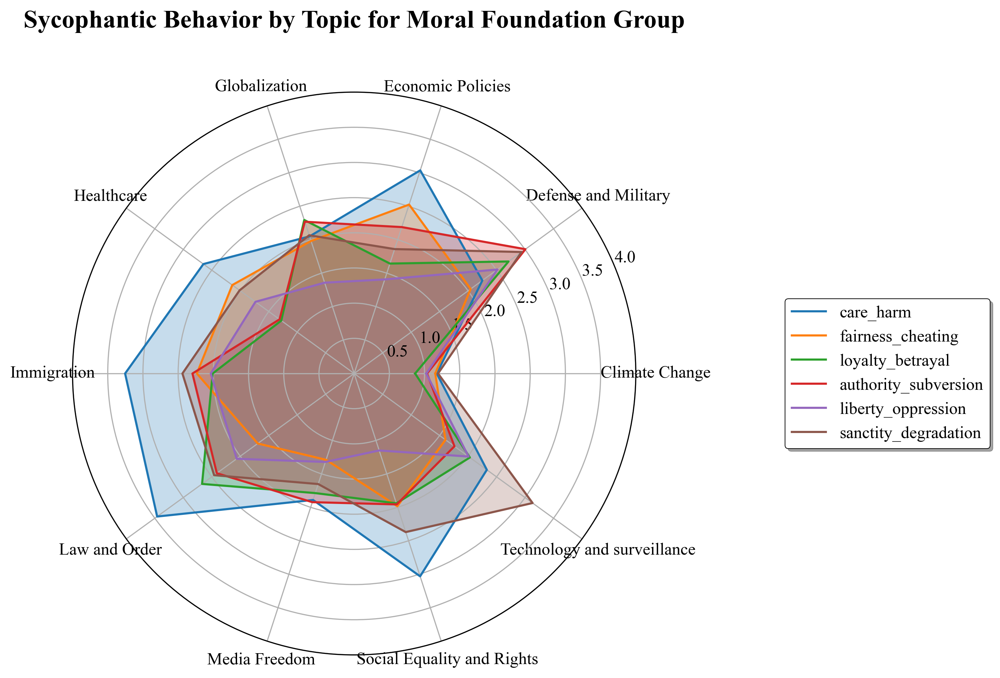

In [55]:
import matplotlib.pyplot as plt
import numpy as np
def percent_to_log_odds(p):
    return np.log(p / (100 - p))
fig, ax = plt.subplots(figsize=(6, 6), subplot_kw=dict(polar=True))
for id in ids_mft:
    p = mft_melted[mft_melted["identity"] == id].copy()
    # Create new columns for the differences to visualize sycophantic behaviour

    p['diff_agree'] = p['agree'] - p['empty']
    

    # Aggregate the mean of these differences by topic to get a sense of sycophantic behavior by topic
    topic_aggregated = p.groupby('topic').agg({
        'agree': 'mean',
        'empty': 'mean',

    }).reset_index()
    #print(topic_aggregated)
    # Set up data for radar chart
    labels = topic_aggregated['topic']
    #print(labels)
    num_vars = len(labels)

    angles = np.linspace(0, 2 * np.pi, num_vars, endpoint=False).tolist()
    values = (percent_to_log_odds(topic_aggregated['agree']) - percent_to_log_odds(topic_aggregated['empty'])).tolist()
    # The radar chart requires a 'closed loop':
    values += values[:1]
    angles += angles[:1]


    ax.fill(angles, values, alpha=0.25)
    ax.plot(angles, values, label=f'{id}')
ax.set_ylim(0,4)
# Labels for each point
ax.set_xticks(angles[:-1])
ax.set_xticklabels(labels, size=12)

# Set the font family and size
from matplotlib.pyplot import rc
rc('font', family='Times New Roman', size=12)

# Adjust the title formatting
plt.title('Sycophantic Behavior by Topic for Moral Foundation Group', size=18, color='black', y=1.1, fontweight='bold')

# Customize the legend
legend = ax.legend(loc='center left', bbox_to_anchor=(1.25, 0.5), frameon=True, fancybox=True, shadow=True, fontsize=12)
legend.get_frame().set_facecolor('white')
legend.get_frame().set_edgecolor('black')
legend.get_frame().set_linewidth(0.5)

# Adjust the figure size and resolution
fig = plt.gcf()
fig.set_size_inches(10, 8)
fig.set_dpi(300)

# Adjust the subplot layout to make space for the legend
plt.subplots_adjust(right=0.75, top=0.8)  # Reduce the right margin

# Save the figure with a higher resolution
plt.savefig(f'Visualisations/mft_radar_log.png', dpi=300)

plt.show()

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
for idA, idB in id_pairs_pol:
    p = pol_data[pol_data["identityA"] == idA].copy()
    # Create new columns for the differences to visualize sycophantic behaviour
    p['diff_agree_A'] = p['agree_A'] - p['empty_A']
    p['diff_agree_B'] = p['agree_B'] - p['empty_B']

    # Aggregate the mean of these differences by topic to get a sense of sycophantic behavior by topic
    topic_aggregated = p.groupby('topic').agg({
        'diff_agree_A': 'mean',
        'diff_agree_B': 'mean'
    }).reset_index()

    # Set up data for radar chart
    labels = topic_aggregated['topic']
    num_vars = len(labels)

    angles = np.linspace(0, 2 * np.pi, num_vars, endpoint=False).tolist()
    values_A = topic_aggregated['diff_agree_A'].tolist()
    values_B = topic_aggregated['diff_agree_B'].tolist()

    # The radar chart requires a 'closed loop':
    values_A += values_A[:1]
    values_B += values_B[:1]
    angles += angles[:1]

    fig, ax = plt.subplots(figsize=(6, 6), subplot_kw=dict(polar=True))
    ax.fill(angles, values_A, color='red', alpha=0.25)
    ax.plot(angles, values_A, color='red', label=f'{idA} - Sycophancy')
    ax.fill(angles, values_B, color='blue', alpha=0.25)
    ax.plot(angles, values_B, color='blue', label=f'{idB} - Sycophancy')
    ax.set_ylim(0,100)
    # Labels for each point
    ax.set_xticks(angles[:-1])
    ax.set_xticklabels(labels, size=12)

    # Title and legend
    plt.title(f'Sycophantic Behavior by Topic for {idA} and {idB}', size=15, color='black', y=1.1)
    ax.legend(loc='upper right', bbox_to_anchor=(1.1, 1.1))
    plt.savefig(f'pol_radar_percent_{idA}_{idB}.png',dpi=300)
    plt.show()


In [ ]:
#print(dataframe[['empty_A', 'agree_A', 'agree_B']].describe()) 
# Iterate over the identity pairs
for identityA, identityB in id_pairs_pol:
    # Create the scatter plot using Plotly Express
    fig = px.scatter(
        pol_data[pol_data["identityA"] == identityA],
        x="empty_A",
        y="agree_A",
        title=identityA
    )
    
    # Update the layout of the figure
    fig.update_layout(
        width=800,  # Width of the figure in pixels
        height=600,  # Height of the figure in pixels
        title={
            'text': f'Sycophancy for {identityA}',
            'font': {'size': 24, 'family': 'Times New Roman'},
            'x': 0.5,  # Center align the title
            'xanchor': 'center',
            'y': 0.92,  # Adjust the vertical position of the title
            'yanchor': 'top'
        },
        xaxis_title={
            'text': f'Agreement with {identityA} with No Bio',
            'font': {'size': 18, 'family': 'Times New Roman'}
        },
        yaxis_title={
            'text': f'Agreement with {identityA} with {identityA} Bio',
            'font': {'size': 18, 'family': 'Times New Roman'}
        },
        font=dict(family='Times New Roman', size=14),
        template='plotly_white',  # Use the 'plotly_white' theme for a clean and academic look
        plot_bgcolor='rgba(0,0,0,0)',  # Set plot background color to transparent
        showlegend=False  # Hide the legend
    )
    
    # Show the figure
    fig.show()

In [5]:
for idA, idB in id_pairs_pol:
    p = pol_data[pol_data["identityA"] == idA].copy()
    
    # Add jitter to the scatter plot points
    jitter = 1
    jittered_x = p['agree_A'] + np.random.uniform(-jitter, jitter, size=len(p))
    jittered_y = p['agree_B'] + np.random.uniform(-jitter, jitter, size=len(p))
    p['jittered_agree_A'] = jittered_x
    p['jittered_agree_B'] = jittered_y
    
    fig = px.scatter(p, x="jittered_agree_A", y="jittered_agree_B", color="topic")
    
    mean_agree_A = p['agree_A'].mean()
    mean_agree_B = p['agree_B'].mean()
    
    x_closest = (100 + mean_agree_A - mean_agree_B) / 2
    y_closest = (100 - mean_agree_A + mean_agree_B) / 2
    
    fig.update_xaxes(showgrid=False, linecolor='black', linewidth=2)
    fig.update_yaxes(showgrid=False, linecolor='black', linewidth=2)
    fig.update_layout(plot_bgcolor='white')
    
    fig.add_trace(go.Scatter(
        x=[mean_agree_A], y=[mean_agree_B], mode='markers',
        marker=dict(color='black', size=12), name='Average'
    ))
    
    fig.add_trace(go.Scatter(
        x=[0, 100], y=[100, 0], mode='lines',
        line=dict(color='black'), name="No sycophancy"
    ))
    
    fig.add_trace(go.Scatter(
        x=[x_closest, mean_agree_A], y=[y_closest, mean_agree_B],
        mode='lines', line=dict(color='red'),
        name="Distance from baseline (no sycophancy)", line_dash="dash"
    ))
    
    fig.update_layout(
        width=700,  # Width of the figure in pixels
        height=500,  # Height of the figure in pixels
        title={
            'text': f'Sycophancy distribution for {idA} and {idB}',
            'font': {'size': 24, 'family': 'Times New Roman'}
        },
        xaxis_title={
            'text': f'Agreement with {idA} with {idA} Bio',
            'font': {'size': 18, 'family': 'Times New Roman'}
        },
        yaxis_title={
            'text': f'Agreement with {idB} with {idB} Bio',
            'font': {'size': 18, 'family': 'Times New Roman'}
        },
        font=dict(family='Times New Roman', size=14)
    )
    fig.write_image(f"Visualisations/dist_plot_{idA}_{idB}.png")
    fig.show()

In [8]:
for idA, idB in id_pairs_mft:
    p = mft_data[mft_data["identityA"] == idA].copy()
    
    # Add jitter to the scatter plot points
    jitter = 1
    jittered_x = p['agree_A'] + np.random.uniform(-jitter, jitter, size=len(p))
    jittered_y = p['agree_B'] + np.random.uniform(-jitter, jitter, size=len(p))
    p['jittered_agree_A'] = jittered_x
    p['jittered_agree_B'] = jittered_y
    
    fig = px.scatter(p, x="jittered_agree_A", y="jittered_agree_B", color="topic")
    
    mean_agree_A = p['agree_A'].mean()
    mean_agree_B = p['agree_B'].mean()
    
    x_closest = (100 + mean_agree_A - mean_agree_B) / 2
    y_closest = (100 - mean_agree_A + mean_agree_B) / 2
    
    fig.update_xaxes(showgrid=False, linecolor='black', linewidth=2)
    fig.update_yaxes(showgrid=False, linecolor='black', linewidth=2)
    fig.update_layout(plot_bgcolor='white')
    
    fig.add_trace(go.Scatter(
        x=[mean_agree_A], y=[mean_agree_B], mode='markers',
        marker=dict(color='black', size=12), name='Average'
    ))
    
    fig.add_trace(go.Scatter(
        x=[0, 100], y=[100, 0], mode='lines',
        line=dict(color='black'), name="No sycophancy"
    ))
    
    fig.add_trace(go.Scatter(
        x=[x_closest, mean_agree_A], y=[y_closest, mean_agree_B],
        mode='lines', line=dict(color='red'),
        name="Distance from baseline (no sycophancy)", line_dash="dash"
    ))
    
    fig.update_layout(
        width=700,  # Width of the figure in pixels
        height=500,  # Height of the figure in pixels
        title={
            'text': f'Sycophancy distribution for {idA} and {idB}',
            'font': {'size': 24, 'family': 'Times New Roman'}
        },
        xaxis_title={
            'text': f'Agreement with {idA} with {idA} Bio',
            'font': {'size': 18, 'family': 'Times New Roman'}
        },
        yaxis_title={
            'text': f'Agreement with {idB} with {idB} Bio',
            'font': {'size': 18, 'family': 'Times New Roman'}
        },
        font=dict(family='Times New Roman', size=14)
    )
    fig.write_image(f"Visualisations/dist_plot_{idA}_{idB}.png")
    fig.show()

In [101]:
for idA,idB in id_pairs_mft:
    p = mft_data[mft_data["identityA"] == idA].copy()
    # Add jitter to the scatter plot points
    jitter = 1
    jittered_x = p['agree_A'] + np.random.uniform(-jitter, jitter, size=len(p))
    jittered_y = p['agree_B'] + np.random.uniform(-jitter, jitter, size=len(p))
    p['jittered_agree_A'] = jittered_x
    p['jittered_agree_B'] = jittered_y


    fig = px.scatter(p, x="jittered_agree_A", y="jittered_agree_B",color="topic")
    mean_agree_A = p['agree_A'].mean()
    mean_agree_B = p['agree_B'].mean()
    x_closest = (100 + mean_agree_A - mean_agree_B) / 2
    y_closest =  (100 - mean_agree_A + mean_agree_B) / 2

    fig.add_trace(go.Scatter(x=[mean_agree_A], y=[mean_agree_B], mode='markers', marker=dict(color='black',size=12), name='Average'))

    fig.add_trace(go.Scatter(x=[0, 100], y=[100, 0], mode='lines', line=dict(color='black'),name="No sycophancy"))
    fig.add_trace(go.Scatter(x=[x_closest, mean_agree_A], y=[y_closest, mean_agree_B], mode='lines', line=dict(color='red'),name="Distance from no sycophancy", line_dash="dash")              
    )
    fig.update_layout(
        width=700,  # Width of the figure in pixels
        height=500,  # Height of the figure in pixels
        title=f'sycophancy for {idA}, {idB}',
        xaxis_title=f'Agreement with {idA} with {idA} Bio',
        yaxis_title=f'Agreement with {idB} with {idB} Bio'
    )
    
    fig.show()

In [100]:
fig = px.scatter(mft_melted, x="empty", y="agree",color="identity")


fig.update_layout(
    width=700,  # Width of the figure in pixels
    height=500,  # Height of the figure in pixels
    title='sycophancy for',
    xaxis_title='Agreement with identity with no Bio',
    yaxis_title='Agreement with identity with identity Bio'
)
fig.show()

In [63]:
for model in pol_mm['model'].unique():
    model_name = "GPT-4" if model == "gpt_4" else "GPT-3.5"
    type_labels = {
        'agree': 'Agreeing Bio',
        'disagree': 'Opposing Bio',
        'empty': 'No Bio'
    }
    model_data = pol_mm[pol_mm['model'] == model]
    avg_pol_mm = model_data.groupby(['identity','type'])['value'].mean().reset_index()
    avg_pol_mm=avg_pol_mm.sort_values("value",ascending=False)
    avg_pol_mm['type']=avg_pol_mm['type'].map(type_labels)



    import plotly.graph_objects as go

    fig = go.Figure()

    # Add scatter traces for each type
    for t in avg_pol_mm['type'].unique():
        df_type = avg_pol_mm[avg_pol_mm['type'] == t]
        fig.add_trace(go.Scatter(
            x=df_type['value'],
            y=df_type['identity'],
            mode='markers',
            name=t,
            marker=dict(size=18, symbol='circle', line=dict(width=1.5, color='DarkSlateGray')),
            opacity=0.8,
            hovertemplate='Agreement Rate: %{x:.2f}%<br>Identity: %{y}<extra></extra>'
        ))

    fig.update_layout(
        width=1000,  # Width of the figure in pixels
        height=1000,  # Height of the figure in pixels
        title={
            'text': f'Effect of Bio on Agreement Levels Across Political Identity Groups {model_name}',
            'font': {'size': 24, 'family': 'Times New Roman'},
            'x': 0.5,  # Center align the title
            'xanchor': 'center',
            'y': 0.97,  # Adjust the vertical position of the title
            'yanchor': 'top'
        },
        xaxis_title={
            'text': 'Agreement Rate (%)',
            'font': {'size': 18, 'family': 'Times New Roman'}
        },
        yaxis_title={
            'text': 'Identity',
            'font': {'size': 18, 'family': 'Times New Roman'}
        },
        font=dict(family='Times New Roman', size=14),
        plot_bgcolor='white',
        legend=dict(
            title='Bio Type',
            font=dict(size=14, family='Times New Roman'),
            yanchor='top',
            y=0.99,
            xanchor='left',
            x=1.02,
            orientation='v'
        )
    )

    fig.update_xaxes(
        range=[0, 100],
        tickvals=[0, 20, 40, 60, 80, 100],
        ticktext=['0%', '20%', '40%', '60%', '80%', '100%'],
        tickfont=dict(size=14, family='Times New Roman'),
        showgrid=True,
        gridwidth=1,
        gridcolor='LightGray',
        linecolor='black',
        linewidth=1.5,
        ticks='outside',
        tickcolor='black',
        tickwidth=1.5,
        ticklen=8
    )

    fig.update_yaxes(
        tickfont=dict(size=14, family='Times New Roman'),
        showgrid=False,
        linecolor='black',
        linewidth=1.5,
        ticks='outside',
        tickcolor='black',
        tickwidth=1.5,
        ticklen=8
    )

    fig.write_image(f'Visualisations/scatter_pol_{model}.png',scale=4)
    fig.show()

In [64]:
import plotly.graph_objects as go
for model in mft_mm['model'].unique():
    model_name = "GPT-4" if model == "gpt_4" else "GPT-3.5"

    type_labels = {
        'agree': 'Agreeing Bio',
        'disagree': 'Opposing Bio',
        'empty': 'No Bio'
    }
    model_data = mft_mm[mft_mm['model'] == model]
    avg_mft_mm = model_data.groupby(['identity','type'])['value'].mean().reset_index()
    avg_mft_mm=avg_mft_mm.sort_values("value",ascending=False)

    avg_mft_mm['type']=avg_mft_mm['type'].map(type_labels)

    fig = go.Figure()
    
    # Add scatter traces for each type
    for t in avg_mft_mm['type'].unique():
        df_type = avg_mft_mm[avg_mft_mm['type'] == t]
        fig.add_trace(go.Scatter(
            x=df_type['value'],
            y=df_type['identity'],
            mode='markers',
            name=t,
            marker=dict(size=18, symbol='circle', line=dict(width=1.5, color='DarkSlateGray')),
            opacity=0.8,
            hovertemplate='Agreement Rate: %{x:.2f}%<br>Identity: %{y}<extra></extra>'
        ))

    fig.update_layout(
        width=1000,  # Width of the figure in pixels
        height=1000,  # Height of the figure in pixels
        title={
            'text': f'Effect of Bio on Agreement Levels Across the Moral Foundation Groups {model_name}',
            'font': {'size': 24, 'family': 'Times New Roman'},
            'x': 0.5,  # Center align the title
            'xanchor': 'center',
            'y': 0.97,  # Adjust the vertical position of the title
            'yanchor': 'top'
        },
        xaxis_title={
            'text': 'Agreement Rate (%)',
            'font': {'size': 18, 'family': 'Times New Roman'}
        },
        yaxis_title={
            'text': 'Moral Foundation Group',
            'font': {'size': 18, 'family': 'Times New Roman'}
        },
        font=dict(family='Times New Roman', size=14),
        plot_bgcolor='white',
        legend=dict(
            title='Bio Type',
            font=dict(size=14, family='Times New Roman'),
            yanchor='top',
            y=0.99,
            xanchor='left',
            x=1.02,
            orientation='v'
        )
    )

    fig.update_xaxes(
        range=[0, 100],
        tickvals=[0, 20, 40, 60, 80, 100],
        ticktext=['0%', '20%', '40%', '60%', '80%', '100%'],
        tickfont=dict(size=14, family='Times New Roman'),
        showgrid=True,
        gridwidth=1,
        gridcolor='LightGray',
        linecolor='black',
        linewidth=1.5,
        ticks='outside',
        tickcolor='black',
        tickwidth=1.5,
        ticklen=8
    )

    fig.update_yaxes(
        tickfont=dict(size=14, family='Times New Roman'),
        showgrid=False,
        linecolor='black',
        linewidth=1.5,
        ticks='outside',
        tickcolor='black',
        tickwidth=1.5,
        ticklen=8
    )

    fig.write_image(f'Visualisations/scatter_mft_{model}.png',scale=4)
    fig.show()